In [1]:
import numpy as np
import matplotlib.pyplot as plt
import sympy as smp
from scipy.integrate import odeint
import plotly.graph_objects as go
from IPython.display import HTML
from scipy.optimize import curve_fit
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d
from matplotlib.animation import FuncAnimation, PillowWriter
from mpl_toolkits.mplot3d.proj3d import proj_transform
from matplotlib.animation import FuncAnimation, FFMpegWriter

from Gyro_Solver import Solve_Gyro_Forced_XY, Solve_Gyro_Free,convert_angle, Stop_Forcing, Get_Gyro_Position, Get_Gyro_Position_X_Only

In [2]:
%matplotlib qt

In [4]:
%matplotlib inline

In [3]:
CI = [np.pi / 12, 0, 0, 0, 0, 2*np.pi*100]

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

x0_ = 2.5 * 1e-2
omega_f = 2 * np.pi *  0.52589 #0.265
params_f = [g_, m_, h_, J1_, J3_, x0_]

larmor_frequency = ((m_ * g_ * h_) / (J3_ * CI[-1])) / (2 * np.pi)
print('Larmor Frequency =', larmor_frequency, 'Hz')

t2 = 10


T, X, Y, Z = Get_Gyro_Position_X_Only(t2, params_f, CI, omega_f)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set(xlim3d=(-1.2, 1.2), xlabel='X')
ax.set(ylim3d=(-1.2, 1.2), ylabel='Y')
ax.set(zlim3d=(-1.2, 1.2), zlabel='Z')
# Tracé initial du point et de la ligne
point, = ax.plot([X[0]], [Y[0]], [Z[0]], 'b.')
line, = ax.plot(X[:1], Y[:1], Z[:1], color='b')

point_static, = ax.plot(0, 0, 0, 'k.')

# Ajouter une flèche
#arrow = FancyArrowPatch((0, 0, 0), (X[0], Y[0], Z[0]), mutation_scale=15, color='blue')
#ax.add_patch(arrow)




# Initialiser la flèche
arrow = ax.quiver(0, 0, 0, 0, 0, 0, color='red', arrow_length_ratio=0.01)

text_time = ax.text2D(0.02, 0.95, '', transform=ax.transAxes, color='black')

text_CI = ax.text2D(0.02, 1, r'$\theta_0 =$' + str(round(CI[0] * 180 / np.pi, 0)) + r'$^\circ$', transform=ax.transAxes, color='black')
text_CI_omega = ax.text2D(0.02, 0.9, r'$f_{\psi} =$' + str(round(CI[-1] / (2 * np.pi), 0)) + '$\;\mathrm{Hz}$', transform=ax.transAxes, color='black')


# Fonction de mise à jour pour l'animation
def update(num, X, Y, Z, point, line, point_static, arrow):
    point.set_data(X[num-1:num], Y[num-1:num])
    point.set_3d_properties(Z[num-1:num])

    line.set_data(X[:num], Y[:num])
    line.set_3d_properties(Z[:num])

    # Mettre à jour la position de la flèche
    arrow.set_segments([[[0, 0, 0], [X[num], Y[num], Z[num]]]])

    text_time.set_text(f'Time: {T[num]:.2f} s')


    return point, line, point_static, arrow

# Augmenter la fréquence de trame pour accélérer l'animation
frame_rate = 100
num_frames = len(T)
interval = 0.001 #1000 / frame_rate

# Animer le tracé
ani = FuncAnimation(fig, update, frames=num_frames, interval=interval,
                    fargs=(X, Y, Z, point, line, point_static, arrow), blit=False)

# Enregistrer l'animation en tant que fichier vidéo avec Pillow
#ani.save('animation_3d_with_arrow.gif', writer=PillowWriter(fps=frame_rate))

ani.save('animation_XONLY_RotatingRef.mp4', writer=FFMpegWriter(fps=frame_rate))



# Afficher le graphique interactif
plt.show()





Larmor Frequency = 0.5294535572787643 Hz


## Régime forcé :

0.5294535572787643
precession frequency = 0.5561075951861449
rotation frequency = 99.60443008763936
179.1099976872262
187.38267703922287


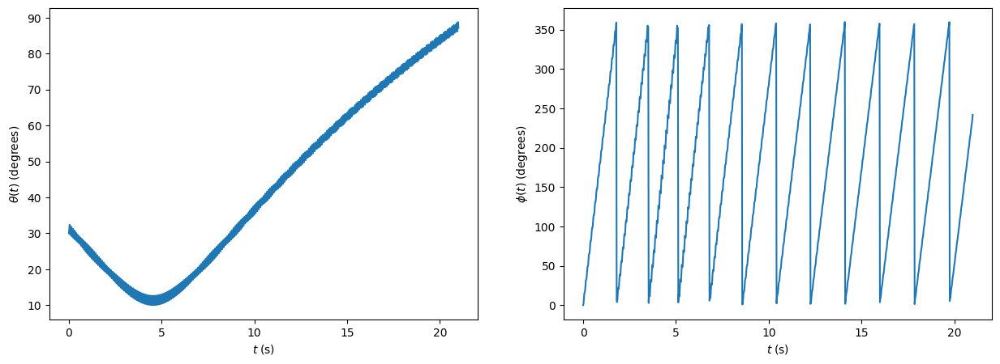

88.78898888599134
10.00248116664046


In [2]:
#CI = [np.pi / 12, 0, 0, 0, 0, 2*np.pi*100]

CI = [np.pi / 6, 0, 0, 0, 0, 2*np.pi*100]

t = np.linspace(0, 21, 1000)

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

x0_ = 2.5 * 1e-2
omega_f = 2 * np.pi *  0.52589 #0.265
params_f = [g_, m_, h_, J1_, J3_, x0_]

larmor_frequency = ((m_ * g_ * h_) / (J3_ * 2*np.pi * 100)) / (2 * np.pi)
print(larmor_frequency)


the_f, phi_f, psi_f,theD_f, phiD_f, psiD_f, path_f = Solve_Gyro_Forced_XY(t, CI, params_f, omega_excitation=omega_f)

print(np.max(the_f) * 180 / np.pi)
print(np.min(the_f) * 180 / np.pi)

path_f


precession frequency = 0.5301631659637733
rotation frequency = 99.98129528742771
188.585895260516
188.80332882698247


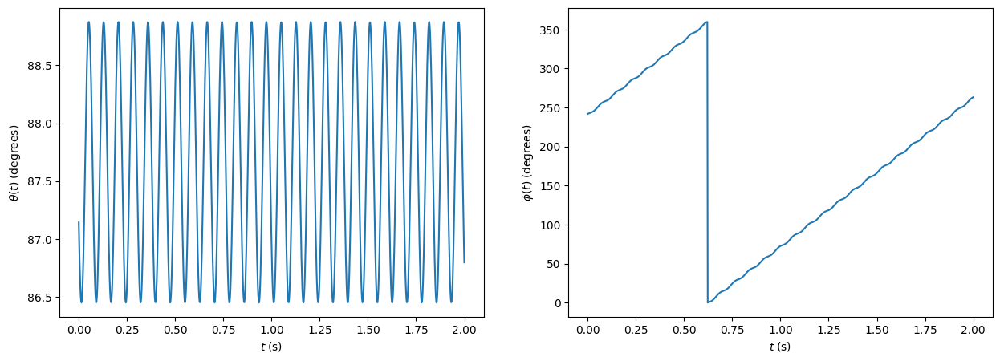

In [3]:
CI2 = [the_f[-1], theD_f[-1], phi_f[-1], phiD_f[-1], psi_f[-1], psiD_f[-1]]

t2 = np.linspace(0, 2, 1000)

params_lib = [g_, m_, h_, J1_, J3_]

the_t_lib, phi_t_lib, psi_t_lib, x_t_lib, y_t_lib, z_t_lib, path_lib = Solve_Gyro_Free(t2, CI2, params_lib)

path_lib

In [4]:
T = np.concatenate((t, t2 + t[-1]))
THETA = np.concatenate((the_f, the_t_lib))
PSI = np.concatenate((psi_f, psi_t_lib))
PHI = np.concatenate((phi_f, phi_t_lib))

X = np.sin(PHI) * np.sin(THETA)
Y = -np.cos(PHI) * np.sin(THETA)
Z = np.cos(THETA)

In [5]:
%matplotlib qt

In [6]:
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d
from matplotlib.animation import FuncAnimation, PillowWriter
from mpl_toolkits.mplot3d.proj3d import proj_transform
from matplotlib.animation import FuncAnimation, FFMpegWriter



Delta_T = T[1] - T[0]

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set(xlim3d=(-1.2, 1.2), xlabel='X')
ax.set(ylim3d=(-1.2, 1.2), ylabel='Y')
ax.set(zlim3d=(-1.2, 1.2), zlabel='Z')
# Tracé initial du point et de la ligne
point, = ax.plot([X[0]], [Y[0]], [Z[0]], 'b.')
line, = ax.plot(X[:1], Y[:1], Z[:1], color='b')

point_static, = ax.plot(0, 0, 0, 'k.')

# Ajouter une flèche
#arrow = FancyArrowPatch((0, 0, 0), (X[0], Y[0], Z[0]), mutation_scale=15, color='blue')
#ax.add_patch(arrow)




# Initialiser la flèche
arrow = ax.quiver(0, 0, 0, 0, 0, 0, color='red', arrow_length_ratio=0.01)

text_time = ax.text2D(0.02, 0.95, '', transform=ax.transAxes, color='black')


# Fonction de mise à jour pour l'animation
def update(num, X, Y, Z, point, line, point_static, arrow):
    point.set_data(X[num-1:num], Y[num-1:num])
    point.set_3d_properties(Z[num-1:num])

    line.set_data(X[:num], Y[:num])
    line.set_3d_properties(Z[:num])

    # Mettre à jour la position de la flèche
    arrow.set_segments([[[0, 0, 0], [X[num], Y[num], Z[num]]]])

    text_time.set_text(f'Time: {T[num]:.2f} s')


    return point, line, point_static, arrow

# Augmenter la fréquence de trame pour accélérer l'animation
frame_rate = 100
num_frames = len(T)
interval = 0.001 #1000 / frame_rate

# Animer le tracé
ani = FuncAnimation(fig, update, frames=num_frames, interval=interval,
                    fargs=(X, Y, Z, point, line, point_static, arrow), blit=False)

# Enregistrer l'animation en tant que fichier vidéo avec Pillow
#ani.save('animation_3d_with_arrow.gif', writer=PillowWriter(fps=frame_rate))

ani.save('animation_3d_with_vector_triangle_time.mp4', writer=FFMpegWriter(fps=frame_rate))



# Afficher le graphique interactif
plt.show()


In [7]:
%matplotlib qt

In [7]:
%matplotlib inline

0.5294535572787643
precession frequency = 0.5532701329304719
rotation frequency = 99.61189124194466
180.04205416680725
187.41075095983666


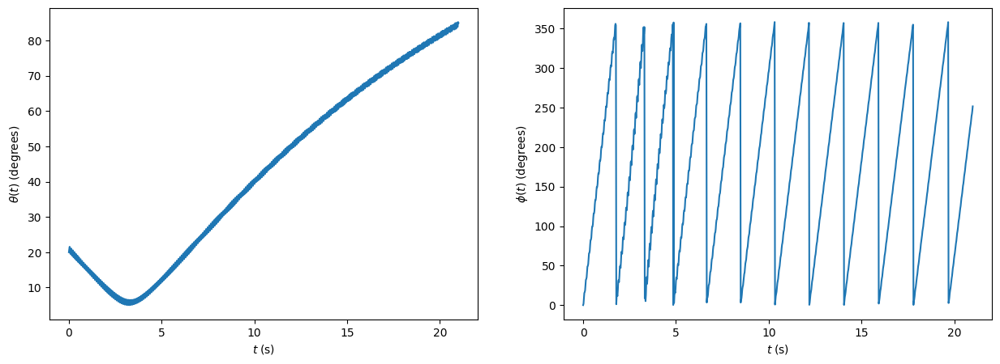

85.22934805963514
5.015164008671983


In [4]:
CI = [np.deg2rad(20), 0, 0, 0, 0, 2*np.pi*100]
t = np.linspace(0, 21, 1000)

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

x0_ = 2.5 * 1e-2
omega_f = 2 * np.pi *  0.52589 #0.265
params_f = [g_, m_, h_, J1_, J3_, x0_]

larmor_frequency = ((m_ * g_ * h_) / (J3_ * 2*np.pi * 100)) / (2 * np.pi)
print(larmor_frequency)


the_f, phi_f, psi_f,theD_f, phiD_f, psiD_f, path_f = Solve_Gyro_Forced_XY(t, CI, params_f, omega_excitation=omega_f)

print(np.max(the_f) * 180 / np.pi)
print(np.min(the_f) * 180 / np.pi)

path_f


precession frequency = 0.5313803180303086
rotation frequency = 99.95128019871285
188.0974451014798
188.68998566576076


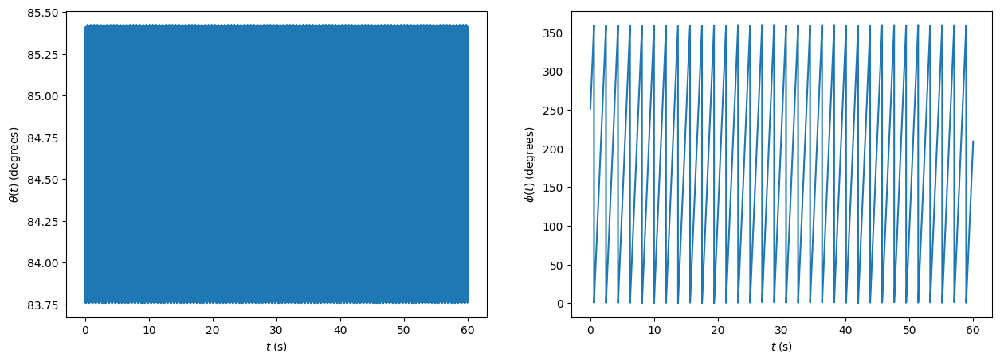

In [5]:
CI2 = [the_f[-1], theD_f[-1], phi_f[-1], phiD_f[-1], psi_f[-1], psiD_f[-1]]

t2 = np.linspace(0, 60, 10000)

params_lib = [g_, m_, h_, J1_, J3_]

the_t_lib, phi_t_lib, psi_t_lib, x_t_lib, y_t_lib, z_t_lib, path_lib = Solve_Gyro_Free(t2, CI2, params_lib)

path_lib

0.5294535572787643
precession frequency = 0.777860376552469
rotation frequency = 99.37427389247809
127.75335637085892
186.51770633883575


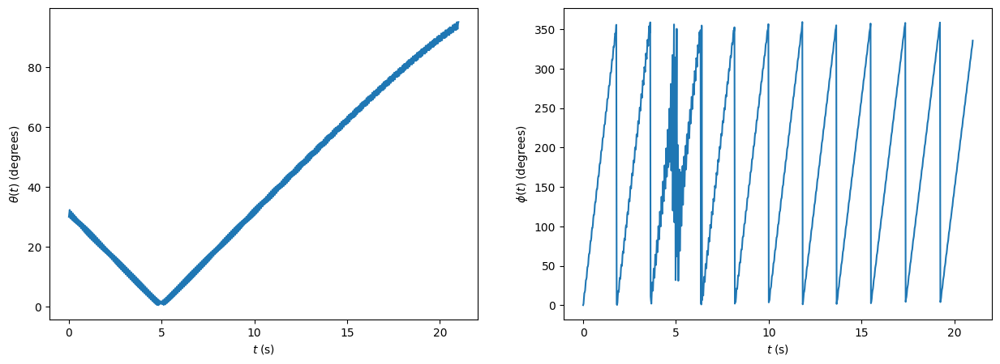

95.22356203985565
0.44224941318544125


In [14]:
CI = [np.deg2rad(30), 0, 0, 0, 0, 2*np.pi*100]
t = np.linspace(0, 21, 1000)

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

x0_ = 2.5 * 1e-2
omega_f = 2 * np.pi *  0.55 #0.265
params_f = [g_, m_, h_, J1_, J3_, x0_]

larmor_frequency = ((m_ * g_ * h_) / (J3_ * 2*np.pi * 100)) / (2 * np.pi)
print(larmor_frequency)


the_f, phi_f, psi_f,theD_f, phiD_f, psiD_f, path_f = Solve_Gyro_Forced_XY(t, CI, params_f, omega_excitation=omega_f)

print(np.max(the_f) * 180 / np.pi)
print(np.min(the_f) * 180 / np.pi)

path_f

precession frequency = 0.5276272885236469
rotation frequency = 100.04224574890695
189.60779308597742
189.03359505081403


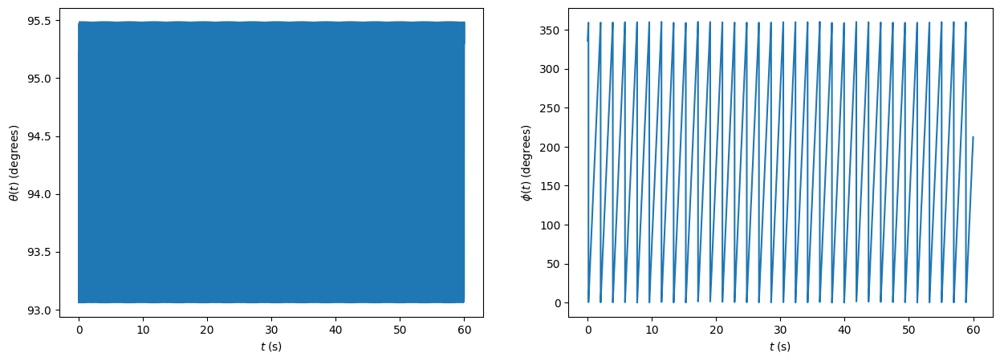

In [15]:
CI2 = [the_f[-1], theD_f[-1], phi_f[-1], phiD_f[-1], psi_f[-1], psiD_f[-1]]

t2 = np.linspace(0, 60, 10000)

params_lib = [g_, m_, h_, J1_, J3_]

the_t_lib, phi_t_lib, psi_t_lib, x_t_lib, y_t_lib, z_t_lib, path_lib = Solve_Gyro_Free(t2, CI2, params_lib)

path_lib

## Gate function :

In [2]:
def Solve_Gyro_Forced(time, CI, params, omega_excitation, plot=True):
    t, h, g, m, x0, w = smp.symbols('t h g m x_0 w', real=True)
    the, phi, psi = smp.symbols(r'\theta \phi \psi', cls=smp.Function)
    #psi = smp.symbols(r'\Pi', cls=smp.Function)
    the = the(t)
    phi = phi(t)
    psi = psi(t)

    S = smp.Heaviside
    porte = S(t + 0.1) - S(t - 30)
    
    # Derivatives
    the_d = smp.diff(the,t)
    phi_d = smp.diff(phi,t)
    psi_d = smp.diff(psi,t)
    # Second derivatives
    the_dd = smp.diff(the_d,t)
    phi_dd = smp.diff(phi_d,t)
    psi_dd = smp.diff(psi_d,t)
    R3 = smp.Matrix([[smp.cos(psi),-smp.sin(psi),0],
                 [smp.sin(psi),smp.cos(psi),0],
                 [0,0,1]])

    R2 = smp.Matrix([[1,0,0],
                     [0,smp.cos(the),-smp.sin(the)],
                     [0,smp.sin(the),smp.cos(the)]])
    
    R1 = smp.Matrix([[smp.cos(phi),-smp.sin(phi),0],
                     [smp.sin(phi),smp.cos(phi),0],
                     [0,0,1]])
    
    R = R1*R2*R3
    xc = h * R@smp.Matrix([0,0,1]) + smp.Matrix([porte * x0 * smp.cos(w * t),porte * x0 * smp.sin(w * t),0])
    vc = smp.diff(xc, t)
    vc_carre = vc.T.dot(vc).simplify()
    omega = smp.Matrix([phi_d*smp.sin(the)*smp.sin(psi)+the_d*smp.cos(psi),
                        phi_d*smp.sin(the)*smp.cos(psi)-the_d*smp.sin(psi),
                        phi_d*smp.cos(the)+psi_d])
    J1, J3 = smp.symbols('J_1, J_3', real=True)
    I = smp.Matrix([[J1,0,0],[0,J1,0],[0,0,J3]])
    T_rot = smp.Rational(1,2)*omega.T.dot(I*omega).simplify()
    T_c = smp.Rational(1,2) * m * vc_carre
    
    
    T = T_c + T_rot
    
    V = m*g*h*smp.cos(the)
    L = T-V
    L = L.simplify()
    LE1 = smp.diff(L, the) - smp.diff(smp.diff(L, the_d), t)
    LE1 = LE1.simplify()
    
    LE2 = smp.diff(L, phi) - smp.diff(smp.diff(L, phi_d), t)
    LE2 = LE2.simplify()
    
    LE3 = smp.diff(L, psi) - smp.diff(smp.diff(L, psi_d), t)
    LE3 = LE3.simplify()

    
    sols = smp.solve([LE1, LE2, LE3], (the_dd, phi_dd, psi_dd),
                    simplify=False, rational=False)
    dz1dt_f = smp.lambdify((t, g, h, m, x0, w, J1, J3,the,phi,psi, porte,the_d,phi_d,psi_d), sols[the_dd])
    dthedt_f = smp.lambdify(the_d, the_d)
    
    dz2dt_f = smp.lambdify((t, g, h, m, x0, w, J1, J3,the,phi,psi, porte,the_d,phi_d,psi_d), sols[phi_dd])
    dphidt_f = smp.lambdify(phi_d, phi_d)
    
    dz3dt_f = smp.lambdify((t, g, h, m, x0, w, J1, J3, the,phi,psi, porte,the_d,phi_d,psi_d), sols[psi_dd])
    dpsidt_f = smp.lambdify(psi_d, psi_d)
    
    def dSdt(S, t):
        the, z1, phi, z2, psi, z3 = S
        return [
            dthedt_f(z1),
            dz1dt_f(t, g, h, m, x0, w, J1, J3, the,phi,psi, porte, z1,z2,z3),
            dphidt_f(z2),
            dz2dt_f(t, g, h, m, x0, w, J1, J3,the,phi,psi, porte, z1,z2,z3),
            dpsidt_f(z3),
            dz3dt_f(t, g, h, m, x0, w, J1, J3,the,phi,psi, porte, z1,z2,z3),
        ]
    
    g, m, h, J1, J3, x0 = params ######### IMPORTANT

    w = omega_excitation
    
    t = time
    # Initial Condition 1
    ans = odeint(dSdt, y0=CI, t=t)

    path = 0
    
    the_t = ans.T[0]
    phi_t = ans.T[2]
    psi_t = ans.T[4]
    x_t = np.sin(phi_t)*np.sin(the_t)
    y_t = -np.cos(phi_t)*np.sin(the_t)
    z_t = np.cos(the_t)

    freq_precession, phi0 = Get_frequency(t, phi_t, 1, 0)
    freq_rotation, psi0 = Get_frequency(t, psi_t, CI[-1], 0)

    

    if plot:
        print('precession frequency =', freq_precession)
        print('rotation frequency =', freq_rotation)
        print(freq_rotation / freq_precession)
        print((J3 * (2*np.pi*freq_rotation)**2) / (m * g * h))
        plt.figure(figsize=[15,5])
        plt.subplot(1,2,1)
        plt.plot(t, the_t * 180 / np.pi)
        plt.ylabel(r'$\theta(t) \; (\mathrm{degrees})$')
        plt.xlabel(r'$t \; (\mathrm{s})$')

        plt.subplot(1,2,2)
        plt.plot(t, convert_angle(phi_t) )
        plt.ylabel(r'$\phi(t) \; (\mathrm{degrees})$')
        plt.xlabel(r'$t \; (\mathrm{s})$')
        plt.show()
 
        i = 0
        f= 1000000
        
        layout = go.Layout(title=r'Plot Title',
                             scene=dict(xaxis_title=r'x',
                                        yaxis_title=r'y',
                                        zaxis_title=r'z',
                                        aspectratio=dict(x=1, y=1, z=1),
                                        camera_eye=dict(x=1.2, y=1.2, z=1.2)))
        
        fig = go.Figure(layout=layout)
        fig.add_scatter3d(x=[0],y=[0],z=[0])
        fig.add_scatter3d(x=x_t[i:f],y=y_t[i:f],z=z_t[i:f], mode='lines',
                          line = dict(color='green', width=2))
        
        fig.update_layout(
            scene = dict(xaxis = dict(range=[-1,1],),
                         yaxis = dict(range=[-1,1],),
                         zaxis = dict(range=[-1,1],),))
        
        path = HTML(fig.to_html(default_width=1000, default_height=600))

        
    return the_t, phi_t, psi_t, x_t, y_t, z_t, path



In [3]:
CI = [np.pi/6, 0, 0, 0, 0, 2*np.pi*100]

t = np.linspace(0, 20, 1000)

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

larmor_frequency = ((m_ * g_ * h_) / (J3_ * 2*np.pi * 100)) / (2 * np.pi)

print(larmor_frequency)

x0_ = 2.5 * 1e-2

params_f = [g_, m_, h_, J1_, J3_, x0_]

omega_f = 2 * np.pi * 0.53 #0.52589


0.5294535572787643


In [4]:
the_t_f, phi_t_f, psi_t_f, x_t_f, y_t_f, z_t_f, path_f = Solve_Gyro_Forced(t, CI, params_f, omega_excitation=omega_f)
np.max(the_t_f)


SyntaxError: invalid syntax (<lambdifygenerated-1>, line 1)